
# Embedding, Clustering & Annotation - Endocrine Cells
Michael Sterr

2021-06-09 14:38:16      


# Setup

Run following scripts before:
 * scRNA-seq_iPSC_IIR-KO_Embedding-Clustering-Annotation_S6-Only_All-Cells.ipynb

In [1]:
#from IPython.core.display import display, HTML
#display(HTML("<style>.container { width:85% !important; }</style>"))

In [2]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging
import time
import pickle
from itertools import chain
import anndata as ad
import gc # Free memory #gc.collect()

#R
#import rpy2
#import rpy2.rinterface_lib.callbacks
#from rpy2.robjects import pandas2ri
#import anndata2ri

# # Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.colors as mcolors
from matplotlib import rcParams
from matplotlib import cm
import seaborn as sb
#from plotnine import *

# # Analysis
import scanpy as sc
import scanpy.external as sce
#import scvelo as scv
#import cellrank as cr

In [3]:
import rpy2
import rpy2.rinterface_lib.callbacks


In [4]:
# Settings

## Scanpy settings
sc.settings.verbosity = 3
#sc.logging.print_versions()

## Scanpy settings
#scv.settings.verbosity = 3
#scv.logging.print_versions()

## Cell Rank settings
#cr.settings.verbosity = 2

## R settings
### Ignore R warning messages
#### Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

### Automatically convert rpy2 outputs to pandas dataframes
#pandas2ri.activate()
#anndata2ri.activate()
#%load_ext rpy2.ipython

#pd.set_option('display.height', 1000)
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 50)
#pd.set_option('display.width', 1000)

# Color Maps

In [5]:
from matplotlib.colors import ListedColormap
# Color maps4
#exec(open("/home/michi/Software/viscm/maps/michi_wt_rd_4.py").read())
#exec(open("/home/michi/Software/viscm/maps/dense.py").read())
#exec(open("/home/michi/Software/viscm/maps/turbo.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn_yl.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_or.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_or_2.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_2.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_3.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_4.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn.py").read())

ch_YlRd=sb.cubehelix_palette(100, start=.7, rot=.25, gamma=0.6, hue=2, light=1, dark=0.05, as_cmap=True)
ch_Bl=sb.cubehelix_palette(100, start=2.65, rot=0, gamma=0.8, hue=1.8, light=1, dark=0, as_cmap=True)
ch_Bl2=sb.cubehelix_palette(100, start=2.75, rot=-.12, gamma=0.8, hue=1.8, light=1, dark=0, as_cmap=True)
ch_Bl2_2=sb.cubehelix_palette(100, start=2.75, rot=-.12, gamma=0.8, hue=1.8, light=0.9, dark=0, as_cmap=True) #

cm_PuGy=ListedColormap(['#ededed', '#ecebec', '#eae9eb', '#e9e7eb', '#e8e5ea', '#e7e4e9', '#e5e2e8', '#e4e0e7', '#e3dee6', '#e1dce6', '#e0dae5', '#dfd8e4', '#ded7e3', '#dcd5e2', '#dbd3e1', '#dad1e1', '#d8cfe0', '#d7cddf', '#d6cbde', '#d5cadd', '#d3c8dc', '#d2c6dc', '#d1c4db', '#cfc2da', '#cec0d9', '#cdbfd8', '#ccbdd7', '#cabbd7', '#c9b9d6', '#c8b7d5', '#c6b5d4', '#c5b4d3', '#c4b2d2', '#c3b0d2', '#c1aed1', '#c0acd0', '#bfabcf', '#bda9ce', '#bca7cd', '#bba5cd', '#b9a3cc', '#b8a2cb', '#b7a0ca', '#b69ec9', '#b49cc8', '#b39ac8', '#b299c7', '#b097c6', '#af95c5', '#ae93c4', '#ac92c3', '#ab90c2', '#aa8ec2', '#a88cc1', '#a78bc0', '#a689bf', '#a487be', '#a385bd', '#a283bd', '#a182bc', '#9f80bb', '#9e7eba', '#9d7db9', '#9b7bb8', '#9a79b8', '#9977b7', '#9776b6', '#9674b5', '#9572b4', '#9370b3', '#926fb3', '#916db2', '#8f6bb1', '#8e69b0', '#8d68af', '#8b66ae', '#8a64ad', '#8863ad', '#8761ac', '#865fab', '#845daa', '#835ca9', '#825aa8', '#8058a8', '#7f57a7', '#7e55a6', '#7c53a5', '#7b52a4', '#7950a3', '#784ea2', '#774ca2', '#754ba1', '#7449a0', '#72479f', '#71469e', '#70449d', '#6e429d', '#6d409c', '#6b3f9b', '#6a3d9a'])
cm_YlBl=ListedColormap(['#ff7f0e', '#fe7f13', '#fc7f17', '#fb7f1a', '#fa7f1d', '#f87f20', '#f77f23', '#f57f26', '#f47f28', '#f37f2a', '#f17f2d', '#f07f2f', '#ee7f31', '#ed7f33', '#ec7f35', '#ea7f37', '#e97e39', '#e77e3b', '#e67e3d', '#e47e3e', '#e37e40', '#e27e42', '#e07e44', '#df7e45', '#dd7e47', '#dc7e49', '#da7e4a', '#d97e4c', '#d77e4e', '#d67e4f', '#d47e51', '#d37e52', '#d17e54', '#d07e55', '#ce7d57', '#cd7d59', '#cb7d5a', '#ca7d5c', '#c87d5d', '#c67d5f', '#c57d60', '#c37d62', '#c27d63', '#c07d64', '#be7d66', '#bd7d67', '#bb7d69', '#b97c6a', '#b87c6c', '#b67c6d', '#b47c6f', '#b37c70', '#b17c71', '#af7c73', '#ad7c74', '#ac7c76', '#aa7c77', '#a87c79', '#a67c7a', '#a47b7b', '#a37b7d', '#a17b7e', '#9f7b80', '#9d7b81', '#9b7b82', '#997b84', '#977b85', '#957b86', '#937b88', '#917a89', '#8e7a8b', '#8c7a8c', '#8a7a8d', '#887a8f', '#867a90', '#837a92', '#817a93', '#7e7a94', '#7c7996', '#797997', '#777998', '#74799a', '#71799b', '#6f799d', '#6c799e', '#69799f', '#6679a1', '#6278a2', '#5f78a3', '#5c78a5', '#5878a6', '#5478a8', '#5078a9', '#4c78aa', '#4878ac', '#4378ad', '#3d77ae', '#3777b0', '#3177b1', '#2977b3', '#1f77b4'])
cm_GnBl=ListedColormap(['#ffffff', '#fbfdfa', '#f7fcf6', '#f3faf2', '#eff8ef', '#ebf6eb', '#e7f4e8', '#e3f3e5', '#dff1e2', '#dbefde', '#d8eddb', '#d4ebd8', '#d0e9d5', '#cce7d2', '#c8e5cf', '#c5e3cf', '#c2e1ce', '#bfdfce', '#bcdccd', '#b9dacd', '#b6d8cd', '#b3d5cc', '#b0d3cb', '#add1cb', '#aaceca', '#a8ccca', '#a5cac9', '#a2c7c8', '#9fc5c8', '#9cc3c7', '#99c1c6', '#97bec5', '#94bcc5', '#91bac4', '#8eb7c3', '#8cb5c2', '#89b3c1', '#86b1c1', '#84aec0', '#81acbf', '#7eaabe', '#7ca7bd', '#79a5bc', '#77a3bb', '#74a1ba', '#729eb9', '#6f9cb8', '#6d9ab7', '#6a98b5', '#6895b4', '#6593b3', '#6391b2', '#608fb1', '#5e8db0', '#5c8aae', '#5988ad', '#5786ac', '#5584ab', '#5281a9', '#507fa8', '#4e7da7', '#4b7ba5', '#4979a4', '#4776a3', '#4574a1', '#4372a0', '#40709e', '#3e6e9d', '#3c6b9c', '#3a699a', '#386799', '#366597', '#346396', '#326194', '#305e92', '#2e5c91', '#2c5a8f', '#2a588e', '#28568c', '#26548b', '#245289', '#225087', '#204d86', '#1e4b84', '#1c4982', '#1a4781', '#18457f', '#16437d', '#14417b', '#123f7a', '#103d78', '#0e3b76', '#0c3974', '#0a3772', '#083571', '#06336f', '#04316d', '#032f6b', '#012d69', '#002a67'])
cm_Bl=ListedColormap(['#ffffff', '#fbfdfc', '#f7fbfb', '#f4f9f9', '#f0f7f8', '#ecf5f7', '#e9f3f5', '#e5f1f4', '#e2eff3', '#deedf2', '#daebf1', '#d7e9f0', '#d3e7ef', '#cfe5ee', '#cce3ed', '#c8e1ec', '#c4dfeb', '#c1ddea', '#bddbe9', '#b9d9e8', '#b6d7e7', '#b2d5e6', '#aed3e5', '#abd1e4', '#a7cfe3', '#a3cde2', '#9fcbe1', '#9cc8e0', '#9ac6df', '#97c4de', '#95c2dd', '#92bfdc', '#90bddb', '#8ebbda', '#8bb8d8', '#89b6d7', '#86b4d6', '#84b2d5', '#82afd4', '#7fadd2', '#7dabd1', '#7ba9d0', '#78a6cf', '#76a4cd', '#73a2cc', '#71a0cb', '#6f9ec9', '#6d9bc8', '#6a99c6', '#6897c5', '#6695c4', '#6393c2', '#6190c1', '#5f8ebf', '#5d8cbe', '#5a8abc', '#5888bb', '#5686b9', '#5483b8', '#5281b6', '#4f7fb5', '#4d7db3', '#4b7bb2', '#4979b0', '#4777ae', '#4575ad', '#4272ab', '#4070a9', '#3e6ea8', '#3c6ca6', '#3a6aa4', '#3868a3', '#3666a1', '#34649f', '#32629d', '#30609b', '#2e5e9a', '#2c5c98', '#2a5a96', '#285794', '#265592', '#245390', '#23518e', '#214f8c', '#1f4d8a', '#1d4b88', '#1b4986', '#1a4784', '#184582', '#164380', '#14417e', '#133f7c', '#113e7a', '#103c78', '#0e3a76', '#0d3874', '#0b3672', '#0a346f', '#09326d', '#08306b'])
cm_BlBk=ListedColormap(['#ffffff', '#fbfcfe', '#f6fafd', '#f2f7fc', '#eef4fa', '#eaf1f9', '#e6eff8', '#e1ecf6', '#dde9f5', '#d9e7f4', '#d5e4f2', '#d1e1f1', '#cddff0', '#c9dcee', '#c4d9ed', '#c0d7ec', '#bcd4ea', '#b8d1e9', '#b4cfe8', '#afcce6', '#abc9e5', '#a7c7e3', '#a3c4e2', '#9ec2e1', '#9abfdf', '#96bcde', '#91badc', '#8db7db', '#89b5da', '#84b2d8', '#80b0d7', '#7badd5', '#76aad4', '#72a8d2', '#6da5d1', '#68a3d0', '#63a0ce', '#5e9ecd', '#589bcb', '#5399ca', '#4d96c9', '#4794c7', '#4291c5', '#408ec3', '#3f8cc0', '#3e89bd', '#3c86bb', '#3b83b8', '#3a80b5', '#397db3', '#377bb0', '#3678ad', '#3575aa', '#3472a7', '#3270a4', '#316da2', '#306a9f', '#2f679c', '#2e6599', '#2d6296', '#2c5f93', '#2a5d90', '#295a8d', '#28588a', '#275586', '#265283', '#255080', '#244d7d', '#234b7a', '#234876', '#224673', '#214470', '#20416d', '#1f3f69', '#1e3c66', '#1e3a62', '#1d385f', '#1c355c', '#1b3358', '#1b3155', '#1a2e51', '#192c4d', '#182a4a', '#182846', '#172642', '#16233f', '#16213b', '#151f37', '#141d34', '#131b30', '#12192c', '#121728', '#111524', '#101320', '#0e101c', '#0c0d19', '#090a14', '#06070f', '#030308', '#000000'])
cm_CatBl=mcolors.ListedColormap(['#ffffff', '#fdfdfe', '#fbfcfd', '#f9fbfc', '#f7f9fb', '#f5f8fa', '#f3f6f9', '#f1f5f8', '#eff3f7', '#edf2f6', '#ebf0f5', '#e9eff4', '#e7edf3', '#e6ecf2', '#e4eaf1', '#e2e9f0', '#e0e7f0', '#dee6ef', '#dce4ee', '#dae3ed', '#d8e1ec', '#d6e0eb', '#d4deea', '#d2dde9', '#d0dbe8', '#cedae7', '#ccd9e6', '#cad7e5', '#c8d6e4', '#c6d4e3', '#c4d3e2', '#c2d1e1', '#c0d0e0', '#bfcedf', '#bdcdde', '#bbccdd', '#b9cadc', '#b7c9db', '#b5c7da', '#b3c6d9', '#b1c4d8', '#afc3d8', '#adc2d7', '#abc0d6', '#a9bfd5', '#a7bdd4', '#a5bcd3', '#a3bad2', '#a1b9d1', '#9fb8d0', '#9db6cf', '#9bb5ce', '#99b3cd', '#97b2cc', '#95b1cb', '#93afca', '#92aec9', '#90acc8', '#8eabc7', '#8caac6', '#8aa8c5', '#88a7c5', '#86a5c4', '#84a4c3', '#82a3c2', '#80a1c1', '#7ea0c0', '#7c9fbf', '#7a9dbe', '#779cbd', '#759abc', '#7399bb', '#7198ba', '#6f96b9', '#6d95b8', '#6b94b7', '#6992b6', '#6791b5', '#6590b5', '#638eb4', '#608db3', '#5e8cb2', '#5c8ab1', '#5a89b0', '#5888af', '#5586ae', '#5385ad', '#5184ac', '#4f82ab', '#4c81aa', '#4a80a9', '#477ea8', '#457da7', '#427ca7', '#407aa6', '#3d79a5', '#3b78a4', '#3877a3', '#3575a2', '#3274a1'])
cm_CatYl=mcolors.ListedColormap(['#ffffff', '#fffefd', '#fffcfb', '#fffbf8', '#fffaf6', '#fff9f4', '#fff7f2', '#fff6f0', '#fff5ee', '#fff3ec', '#fff2e9', '#fff1e7', '#ffefe5', '#ffeee3', '#ffede1', '#ffecde', '#ffeadc', '#ffe9da', '#ffe8d8', '#ffe6d6', '#ffe5d4', '#ffe4d1', '#ffe2cf', '#ffe1cd', '#ffe0cb', '#ffdec9', '#ffddc6', '#fedcc4', '#fedbc2', '#fed9c0', '#fed8be', '#fed7bc', '#fed5ba', '#fdd4b8', '#fdd3b5', '#fdd2b3', '#fdd0b1', '#fdcfaf', '#fccead', '#fcccab', '#fccba9', '#fccaa7', '#fbc9a5', '#fbc7a2', '#fbc6a0', '#fbc59e', '#fac39c', '#fac29a', '#fac198', '#f9c096', '#f9be94', '#f9bd92', '#f8bc90', '#f8bb8e', '#f8b98c', '#f7b889', '#f7b787', '#f6b685', '#f6b483', '#f6b381', '#f5b27f', '#f5b07d', '#f5af7b', '#f4ae79', '#f4ad77', '#f3ab75', '#f3aa73', '#f2a971', '#f2a86f', '#f1a66d', '#f1a56b', '#f1a468', '#f0a366', '#f0a164', '#efa062', '#ef9f60', '#ee9e5e', '#ee9c5c', '#ed9b5a', '#ed9a58', '#ec9956', '#ec9754', '#eb9652', '#ea9550', '#ea944d', '#e9924b', '#e99149', '#e89047', '#e88f45', '#e78d43', '#e68c41', '#e68b3e', '#e58a3c', '#e5883a', '#e48738', '#e38635', '#e38533', '#e28331', '#e2822e', '#e1812c'])

In [6]:
# Plot settings
%matplotlib inline

## Directory
#sc.settings.figdir='/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Figures'

## Plotting parameters
#rcParams['figure.figsize']=(20,20) #rescale figures
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False, color_map='tab10' ,transparent=True, dpi=150, dpi_save=300)
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False ,transparent=True, dpi=150, dpi_save=300)

## Font
#rcParams['font.family'] = 'sans-serif'
#rcParams['font.sans-serif'] = ['Source Sans 3']

## Grid & Ticks
#rcParams['grid.alpha'] = 0
#rcParams['xtick.bottom'] = True
#rcParams['ytick.left'] = True

## Embed font
#plt.rc('pdf', fonttype=42)

## Define new default settings
#plt.rcParamsDefault = plt.rcParams

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(8,8))

# Load Data

In [7]:
adata=sc.read('/Users/dominik.klein/data/E14-E15_adata_filtered_rmDoublets_sctNormalized_WNN_embedded_initialAnno_intermediate.h5ad')

In [8]:
# Load cell cycle genes

## KEGG cell cycle genes
cc_kegg = pd.read_table('/Users/dominik.klein/Downloads/KEGG_mmu_Cell_Cycle.txt').iloc[:,0].tolist()

## Cell cycle genes Regev lab (Tirosh et al. 2016, DOI: 10.1126/science.aad0501)
cc_genes_regev = [x.strip() for x in open('//Users/dominik.klein/Downloads/regev_cell_cycle_genes.txt')]

s_genes_regev = [gene.lower().capitalize() for gene in cc_genes_regev[:43]]
g2m_genes_regev = [gene.lower().capitalize() for gene in cc_genes_regev[43:]]

cc_genes_regev = [gene.lower().capitalize() for gene in cc_genes_regev]

## Cell cycle genes Macosko et al. 2015, https://doi.org/10.1016/j.cell.2015.05.002
#cc_genes_macosko = pd.read_table('/mnt/ssd/Resources/Macosko_cell_cycle_genes.txt', delimiter='\t')

#s_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['S'].dropna())]
#g2m_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['G2.M'].dropna())]
#m_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['M'].dropna())]
#mg1_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['M.G1'].dropna())]
#g1s_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['IG1.S'].dropna())]

#cc_genes_macosko = s_genes_macosko + g2m_genes_macosko + m_genes_macosko + mg1_genes_macosko + g1s_genes_macosko

## Combine all
all_cc_genes = list(set(cc_kegg + cc_genes_regev))# + cc_genes_macosko))

In [9]:
# Marker genes mouse pancreas (pair-wise)
marker_genes_mouse = dict()
marker_genes_mouse['Mat. Acinar'] = ['Arhgdig','Ass1','Cckar','Cel','Cela1','Cldn10','Dhx34','Edem1','Edem2','Erp27','Fkbp11','Gamt','Gcat','Gstm1','Mt1','Nupr1','Pnliprp1','Rbpjl','Reep5','Serpini2','Spink1','Tmem97']
marker_genes_mouse['Trunk'] = ['Actb']
marker_genes_mouse['Prlf. Trunk'] = ['H2afz']
marker_genes_mouse['Ngn3 high EP'] = ['Btbd17','Cbfa2t3','Cotl1','Gadd45a','Hes6','Mtch1','Neurog3','Ppp1r14a','Smarcd2','Tmsb4x']
marker_genes_mouse['Fev+'] = ['Fev', 'Krt7']
marker_genes_mouse['Beta'] = ['1110008P14Rik', 'Gng12', 'Mafb', 'Papss2']
marker_genes_mouse['Alpha'] = ['BC048546', 'Peg10', 'Slc38a5', 'Tmem27', 'Ttr', 'Tmsb15l']
marker_genes_mouse['Delta'] = ['Cd24a', 'Hhex', 'Pyy', 'Rbp4', 'Sst']
marker_genes_mouse['Epsilon'] = ['Ghrl', 'Maged2', 'Mboat4']
marker_genes_mouse['Multipotent'] = ['Npm1', 'Ppia']
marker_genes_mouse['Acinar'] = ['Car9','Cbs', 'Cckar','Cel','Cela1','Cldn10','Edem1','Erp27','Gamt','Gcat','Gstm1','Igf1','Nupr1','Ptf1a','Rbpjl','Reep5','Serpini2','Tmem97']
marker_genes_mouse['primary Alpha'] = ['Sct', 'Slc38a5']
#marker_genes_mouse[] = []

# Marker genes mouse pancreas unique versus rest
marker_genes_mouse2 = dict()
marker_genes_mouse2['Multipotent'] = ['Eef2', 'Rpl38', 'Rpl22', 'Rpl7a', 'Eef1b2', 'Btf3', 'Gnb2l1', 'Pabpc1']
marker_genes_mouse2['Tip'] = ['Smco4', 'Bzw2', 'Gcsh', 'Nme4', 'Cpn1', 'Mpp6', 'Gpc3', 'Tcf15', 'Capn6', 'Nop56', 'Trp53', 'Sdc1', 'Afp', 'Cdca7', 'Hyal2', 'Nrp1', 'P2rx1', 'Ccnd2', 'Jam3', 'Myc', 'Prss23', 'Ccdc30', 'Trf', 'Tnfaip8', 'Gulo', 'Dkc1', 'Fermt1', 'Vtn', 'Cda', 'Fbl', 'Zfp503', 'Rhov', 'Gsto1', 'Acvr2b', 'Noxa1', 'Id3', 'Apoe', 'Chst2', 'Ogfrl1', 'Sdpr', 'Nipsnap1', 'Ung', 'Hmgb3', 'Ruvbl1', 'Sez6', 'Igf2bp1', 'Igfbp4', 'Frem2', 'Flrt2', 'Dcakd', 'Mest', 'Cdca7l', 'Ppif', 'Dctd', 'Atic', 'Paics', 'Fbln1', 'Kirrel2', 'Rcbtb2', 'Gc', 'Dusp9', 'Car14', 'Hmga1-rs1', 'Hmga1', 'Phgdh', 'Gnl3', 'Stmn1', 'Dctpp1', 'Gar1', 'Matn4', 'Serf1', 'Rcn3', 'Ruvbl2', 'Sept9', 'Fzd2', 'Wdr77', 'Trim28', 'Pltp', 'Bmp7', 'Igfbp2', 'Shmt1', 'Crabp1', 'Mcm7', 'Etv4', 'Prdx6', 'Fam60a', 'Pcbp4', 'Apex1', 'C1qbp', 'Rcan2']
marker_genes_mouse2['Prlf. Tip'] = ['Cdca7l', 'Ccnf', 'Mpp6', 'Nasp', 'Cdca4', 'Eme1', 'Rad51ap1', 'Ncaph', 'Ezh2', 'Cdca5', 'Skp2', 'Vrk1', 'Exo1', 'Ube2t', 'Dut', 'Hist1h2ae', 'Trip13', 'Kif22', 'Cenpn', 'Rrm1', 'Fam64a', 'Kif2c', 'Dscc1', 'Mns1', 'Aars', 'Pcna', 'Mcm7', 'Cenpw', 'Fignl1', 'Rcc1', 'Clspn']
marker_genes_mouse2['Trunk'] = ['mt-Co2', 'H2afz', 'Notch2', 'Hmgn1', 'Hnrnpa1', 'Rpgrip1', 'mt-Co3', 'mt-Nd1']
marker_genes_mouse2['Prlf. Trunk'] = ['Supt16', 'Hmgn2', 'Sumo2', 'Ran', 'Ranbp1', 'Hmgn1', 'Dynll1', 'Hnrnpa1', 'Rpgrip1', 'H2afz', 'Anp32b']
marker_genes_mouse2['Prlf. Acinar'] = ['Pigf', 'Suclg2', 'Pla1a', 'Akr1c13', 'Ddc', 'Uchl5', 'Add3', 'Pa2g4', 'Gart', 'Gata4', 'Galk1', 'Lyar', 'Tinag', 'Vars', 'Gar1', 'Tex30', 'Wdtc1', 'Ifrd2', 'Mthfd1', 'Pold2', 'Atad3a', 'Phlda1', 'Ptn', 'Igf2', 'Umps', 'Aldh1b1', 'Slc38a3', 'Plk2', 'Akap7']
marker_genes_mouse2['Mat. Acinar'] = ['Try10', 'Clps', 'Tram1', 'C1qa', 'Ssr1', 'Prss1', 'Dap', 'Tspan13', 'Atp5g1', 'Bhlha15', 'Car9', 'Cela3b', 'Bcat2', 'Ldha', 'Arhgdig', 'Dhrs7', 'Rexo2', 'Ssr4', 'Ass1', 'Ppib', 'Ang', 'Lgals1', 'Tob1', 'Fabp5', 'Ttc23', 'Sel1l', 'Lin37', 'Tmed3', 'P4hb', 'Pdia2', 'Ostc', 'Herpud1', 'Dnajc3', 'Tmem147', 'Clu', 'Rap1gap', 'Rps27l', 'Kctd14', 'Fkbp2', 'Serp1', 'Mlec', 'Sephs2', 'Sdf2l1', 'Edem1', 'Edem2', 'Krtcap2', 'Aqp8', 'Sepp1', 'Tmem238', 'Try5', 'Dhx34', 'Msrb1', 'Bckdk', 'Fam46c', 'Erp27', 'Vimp', 'Mrps24', 'Rrbp1', 'Gm15915', 'Cpb1', 'Rnase4', 'Fkbp11', 'Cela2a', 'Prss2']
marker_genes_mouse2['Ductal'] = ['Hpgd', 'Rassf10', 'Fmo2', 'Ugt2b34', 'Cdc42ep1', 'Gm266', 'Fjx1', 'Trip6', 'Slco3a1', 'Cited1', 'Cadm1', 'Gpt2', 'Rhob', 'Rxrg', 'Igsf3', 'Sphk1', 'Fam89a', 'Ctsh', 'Nrarp', 'Mycn', 'Tubb2b', 'Nav2', 'Ajuba', 'Ncald', 'Akr1cl', 'Eno1', 'S100a16', 'Cnn3']
marker_genes_mouse2['Prlf. Ductal'] = ['Kif11', '2700094K13Rik', 'Dnajc9', 'Ccdc34', 'Cited1', 'Slco3a1', 'Cadm1', 'Melk', 'Kif23', 'Kif20a', 'Nuf2', 'Nrarp', 'Tuba1c', 'Bub3', 'Mki67', 'Asf1b', 'Mxd3']
marker_genes_mouse2['Ngn3 low EP'] = ['Gas2', 'Fndc5', 'Dbi', 'Fabp3', 'Ptprf', 'Cxcl12', 'Tmem171', 'Fam159a', 'Igf1r', 'Nrtn', 'Crp', 'Grin3a', 'Trim47', 'Mia', 'Enpp2', 'Ndrg2', 'Slc28a3', 'Lamb1', 'Kcnk1', 'Zfhx3', 'Eps8l2', 'Gal3st1', 'Mesdc1', 'Slc2a2', 'Ckb', 'Rbms3', 'Krt18', 'Wapl', 'Anxa5']
marker_genes_mouse2['Ngn3 High early'] = ['Spsb4', 'Kdm1a', 'Pard3', 'Gm8773', 'Fgd2', 'Rasl11b', 'Enc1', 'Tpm4', 'Gtf2a2', 'Agap3', 'Sox11', 'Phc2', 'Lrrn2', 'Glrx3', 'Csnk1e', 'Ssbp3', 'Ppp1r14b', 'Plk3', 'Chd7', 'Steap1']
marker_genes_mouse2['Ngn3 High late'] = ['Ly6e', 'Ifitm2', 'Swt1', 'Hspa8', 'Rnf114', 'Traf4', 'Shf', 'Tpst2', 'Sulf2', 'Sult2b1', '2010107G23Rik', 'Prdx2', 'Eif3f']
marker_genes_mouse2['Fev+ Beta'] = ['Nisch', 'Clta', 'Npepl1', 'Cox7a2l']
marker_genes_mouse2['Beta'] = ['Papss2', 'Ins2', 'Mien1', 'Ece1', 'Nnat', 'Mlxipl', 'Entpd3', 'Gjd2', 'Atp6v1e1', 'Pcsk1', 'Sec61b', 'Immp1l', 'Pdx1', 'Atp2a2', 'Ociad2']
marker_genes_mouse2['Fev+ Alpha'] = ['Cd164l2', 'Dst', 'Irf2bpl', 'Gm43861', 'Gnai2', 'Pnmal1', 'Klhl7', 'Tekt2', 'Qdpr', 'Zwint']
marker_genes_mouse2['primary Alpha'] = ['Dnajc12', 'Asb4', 'Uqcc2', 'Ptprn', 'Wnk3', 'Cd81', 'Ly6h', 'Emc10', 'Edn3', 'Slc14a2', 'Ndufv3', 'Atp6v0e2', 'Dohh', 'Nudt11', 'Mapk15', 'Rab37', '2210013O21Rik', 'Ctsz', 'Nap1l5', 'Syt7', 'Tma7', 'Snrpn', 'Gm11716', 'Basp1', 'Sgce']
marker_genes_mouse2['secondary Alpha'] = ['Ncam1', 'Sphkap', 'Sez6l2', 'Ush1c']
marker_genes_mouse2['Alpha'] = ['Dnajc12', 'Irx1', 'Ttr', 'Ndn', 'Wnk3', 'Ncam1', 'Resp18', 'Sct', 'Gcg', 'BC048546', 'Tmsb15l', 'Efcab1', 'Tmsb15b2', 'Sphkap', 'Ush1c', 'Dock11']
marker_genes_mouse2['Fev+ Pyy'] = ['Gde1', 'Pgrmc1', 'Fam216a', 'Rsrp1', 'Mbnl2', 'Pou3f4', 'Usp18', 'Gprasp2']
marker_genes_mouse2['Fev+ Delta'] = ['Yipf4', 'Camk2n2', 'Ppp2r5b', 'B630019K06Rik', 'Dctn3']
marker_genes_mouse2['Fev+ Epsilon'] = ['Tmem184c', 'Psmc2', 'Spint1', 'Ubl3', 'Sdcbp', 'Pclo', 'Lpcat3', 'Hpca', 'Cer1', 'Drap1', 'Lrrc42', 'Ppp3ca', 'Abhd15']
marker_genes_mouse2['Delta'] = ['Pld3', 'Frzb', 'Auts2', 'Kcnmb2', 'Sst', 'Cd24a', 'Smim14', 'Manf', 'Spcs2', 'Fam46a', 'Th', 'Ramp1', 'PISD', 'Kctd8', 'Hadh', 'Ssr2', 'Ddost', 'Erp29', 'Fam159b', 'Ppp1r14c', 'Ywhaq']
marker_genes_mouse2['Epsilon'] = ['Maged2', 'Txndc12', 'Prdx5', 'Cd164', 'Gng4', 'Pnmal2', 'Card19', 'Fam174a', 'Gm11837', 'Lrrtm3', 'Sin3b', 'Alcam', 'Ghrl', 'Lamp1', 'Fhl2', 'Anpep', 'Rbpms', 'Atraid']


In [10]:
# marker genes from Bastidas-Ponce et al., 2019
marker_genes_mouse3=dict()
marker_genes_mouse3['Multipotent'] = ['MDK', 'Btf3', 'Dlk1']
marker_genes_mouse3['Tip'] = ["Cpa1","Myc", "Vtn", "Jam3"] # Cpa1 good marker
marker_genes_mouse3["Trunk"] = ["Notch2", "Hmgn1", "Ybx1"]
marker_genes_mouse3["Acinar"] = ["Ptf1a", "Cpa1", "Cel", "Rbpjl", 'Reep5']
marker_genes_mouse3["Ductal"] = ["Sox9", "Anxa2","Bicc1", "Spp1"]
marker_genes_mouse3["EP"] = ["Ngn3", "Hes6", "Btbd17", "Gadd45a"]
marker_genes_mouse3['Fev+'] = ["Fev", "Cck", "Neurod1", "Vwa5b2", "Tox3"]
marker_genes_mouse3['Endocrine'] = ["Rbp4", "Pyy","Chgb"]


In [11]:
init_clus_dict = {
    
    '0':['NGN3 low EP', 'Ductal'],
    '1':['Fev+', 'Fev+ Beta', 'Fev+ Alpha', 'Fev+ Pyy', 'Fev+ Delta', 'Fev+ Epsilon'],
    '2':['Ngn3 High late', 'Fev+', 'Fev+ Beta', 'Fev+ Alpha', 'Fev+ Pyy', 'Fev+ Delta', 'Fev+ Epsilon'],
    '3':['Fev+ Beta', 'Fev+'],
    '4':['Prlf. Ductal', 'Multipotent', 'Ductal'],
    '5':['Multipotent', 'Prlf. Acinar', 'Acinar'],
    '6':['Ngn3 High early', 'Ngn3 High late', 'Ngn3 low EP'],
    '7':['Prlf. Acinar', 'Mature Acinar'],
    '8':['Ngn3 low EP'],
    '9':['Multipotent'],
    '10':['Ngn3 High late', 'Ngn3 High early', 'Ngn3 low'],
    '11':['Multipotent', 'Ductal', 'Prlf. Ductal'],
    '12':['Fev+ Alpha', 'secondary Alpha', 'Alpha'],
    '13':['Fev+ Alpha', 'secondary Alpha', 'Alpha'],
    '14':['Beta'],
    '15':['Fev+ Alpha', 'Fev+ Epsilon', 'Fev+'],
    '16':['Acinar', 'Mat. Acinar'],
    '17':['Ngn3 low EP', 'Ductal'],
    '18':['Ngn3 High cycling', 'Prlf. Ductal', 'Ngn3 High early', 'Ngn3 High late'],
    '19':['Fev+ Alpha', 'Delta', 'Fev+ Delta'],
    '20':['Ngn3 low EP', 'Ductal'],
}

Subcluster 12

In [12]:
c_id = 12

In [13]:
init_clus_dict[str(c_id)]

['Fev+ Alpha', 'secondary Alpha', 'Alpha']

In [14]:
orig_key = 'leiden_sub8'
new_key = 'leiden_sub9' 
new_rg_key = 'rg_sub9'
sub_key = str(c_id)

running Leiden clustering
    finished: found 35 clusters and added
    'leiden_sub9', the cluster labels (adata.obs, categorical) (0:00:00)


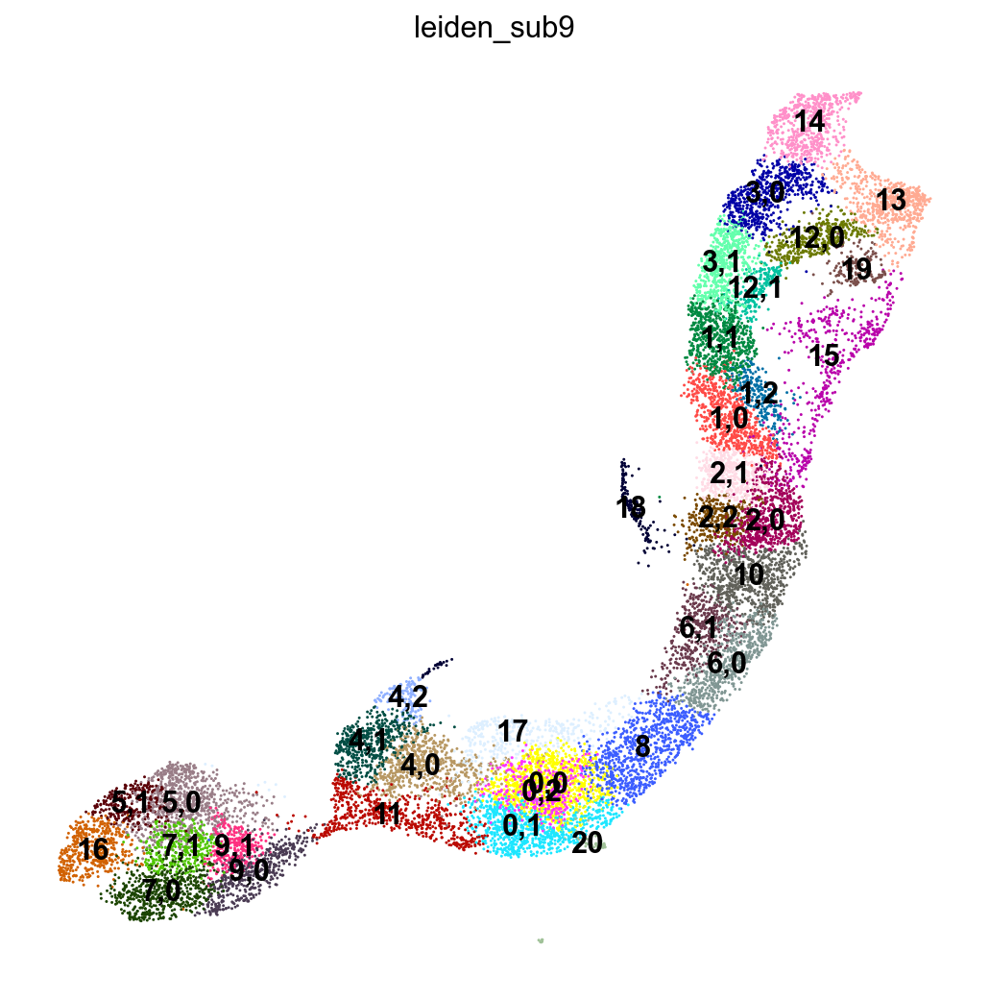

0,0     989
5,0     834
8       819
0,1     785
10      739
1,0     651
1,1     643
11      635
3,0     629
4,0     619
3,1     613
2,0     605
13      591
14      584
7,0     561
6,0     558
15      502
4,1     498
9,0     491
16      456
2,1     453
6,1     437
12,0    398
17      393
2,2     344
7,1     317
0,2     314
9,1     306
5,1     265
1,2     236
12,1    197
18      180
19      161
4,2     124
20       51
Name: leiden_sub9, dtype: int64

In [15]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub9']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Fev+ Alpha, Alpha, secondary Alpha


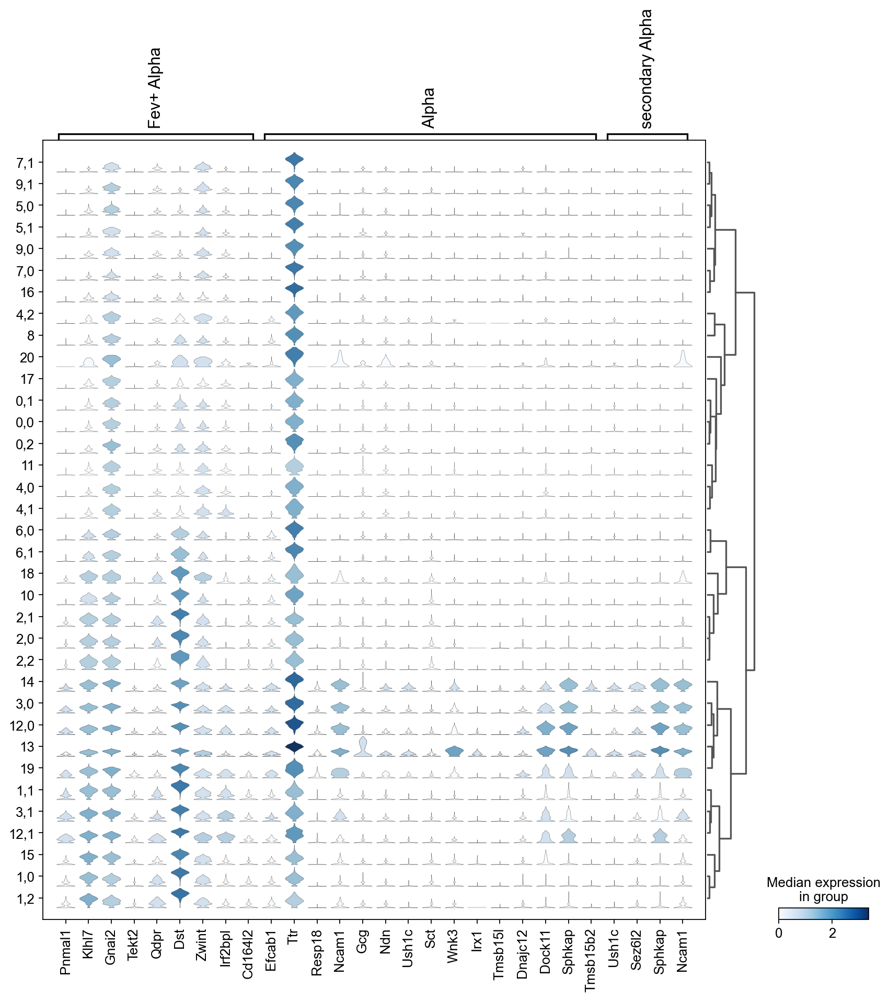

In [16]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Fev+ Alpha', 'Alpha', 'secondary Alpha']
}, groupby=new_key, dendrogram=True)

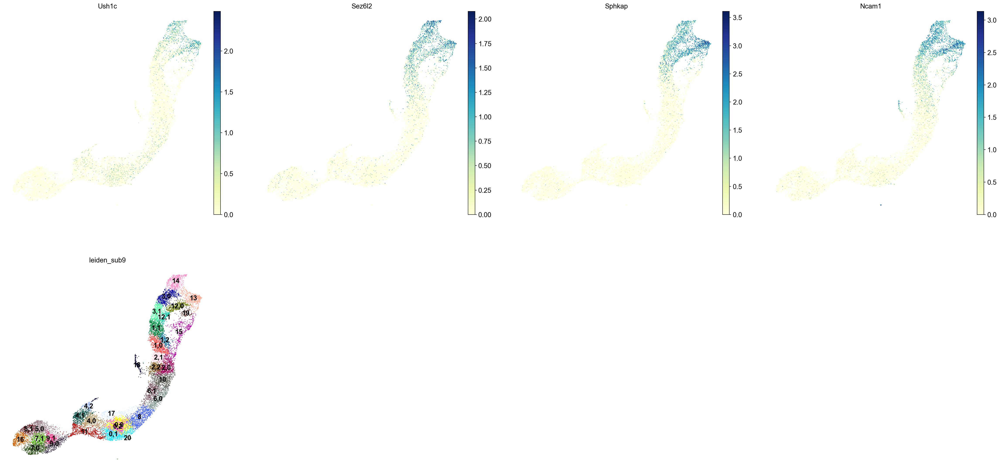

In [17]:
sc.pl.umap(adata, color=list(set(marker_genes_mouse2["secondary Alpha"]).intersection(adata.var.index))+ [new_key],legend_loc='on data') 

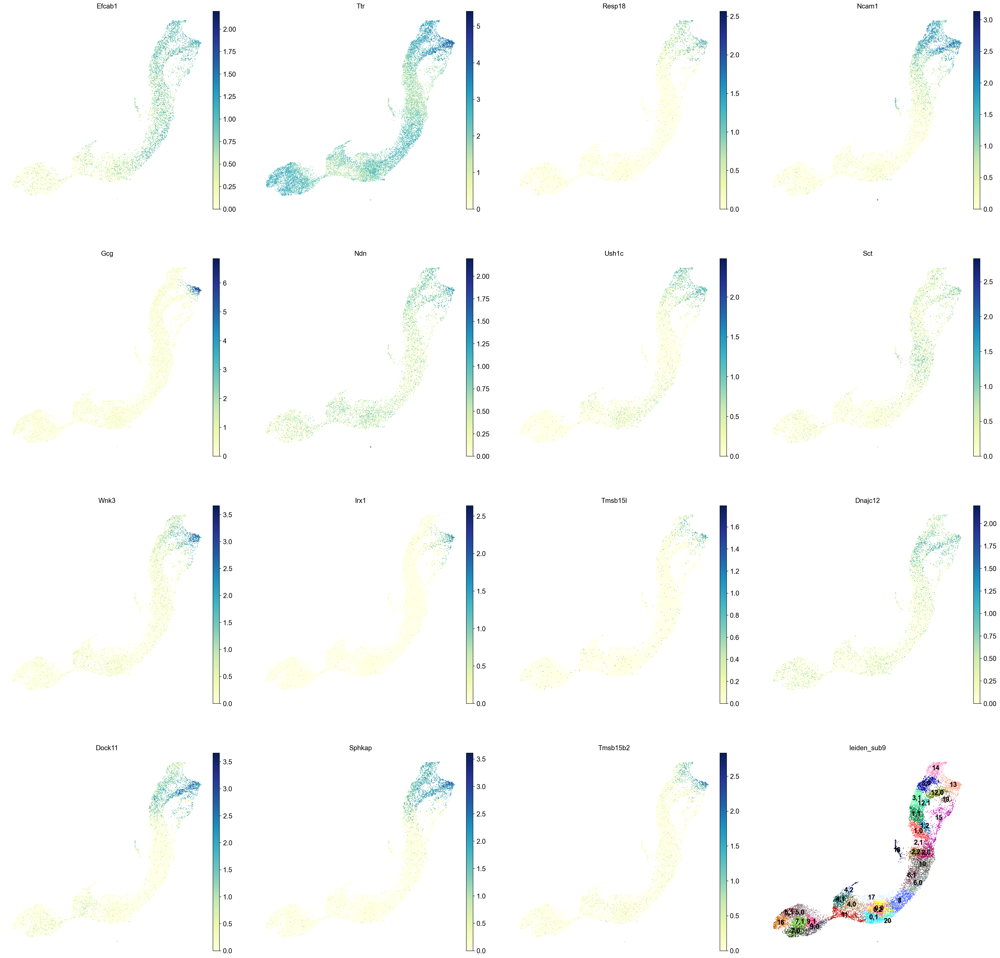

In [18]:
sc.pl.umap(adata, color=list(set(marker_genes_mouse2["Alpha"]).intersection(adata.var.index))+ [new_key],legend_loc='on data') 

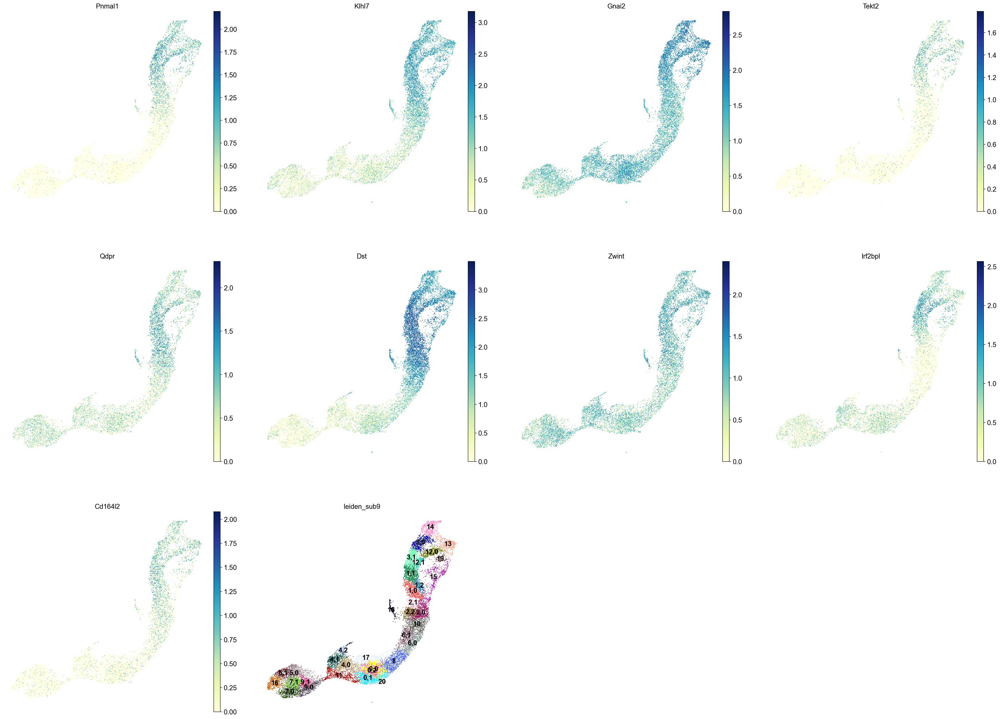

In [19]:
sc.pl.umap(adata, color=list(set(marker_genes_mouse2["Fev+ Alpha"]).intersection(adata.var.index))+ [new_key],legend_loc='on data') 

- 12,0 Alpha
- 12,1: Fev+ Alpha


Subcluster 13

In [20]:
c_id = 13

In [21]:
init_clus_dict[str(c_id)]

['Fev+ Alpha', 'secondary Alpha', 'Alpha']

In [22]:
orig_key = 'leiden_sub9'
new_key = 'leiden_sub10' 
new_rg_key = 'rg_sub10'
sub_key = str(c_id)

running Leiden clustering
    finished: found 36 clusters and added
    'leiden_sub10', the cluster labels (adata.obs, categorical) (0:00:00)


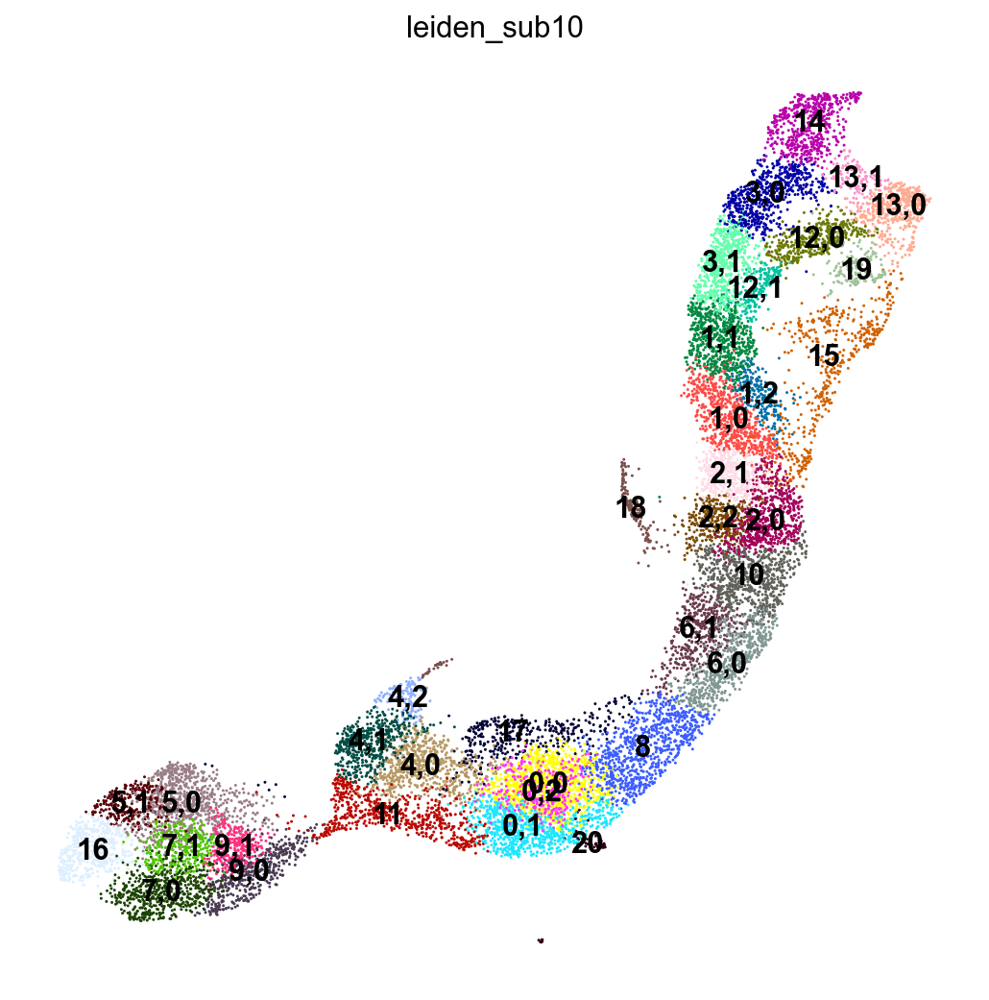

0,0     989
5,0     834
8       819
0,1     785
10      739
1,0     651
1,1     643
11      635
3,0     629
4,0     619
3,1     613
2,0     605
14      584
7,0     561
6,0     558
15      502
4,1     498
9,0     491
13,0    466
16      456
2,1     453
6,1     437
12,0    398
17      393
2,2     344
7,1     317
0,2     314
9,1     306
5,1     265
1,2     236
12,1    197
18      180
19      161
13,1    125
4,2     124
20       51
Name: leiden_sub10, dtype: int64

In [23]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub10']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Beta, Alpha, secondary Alpha


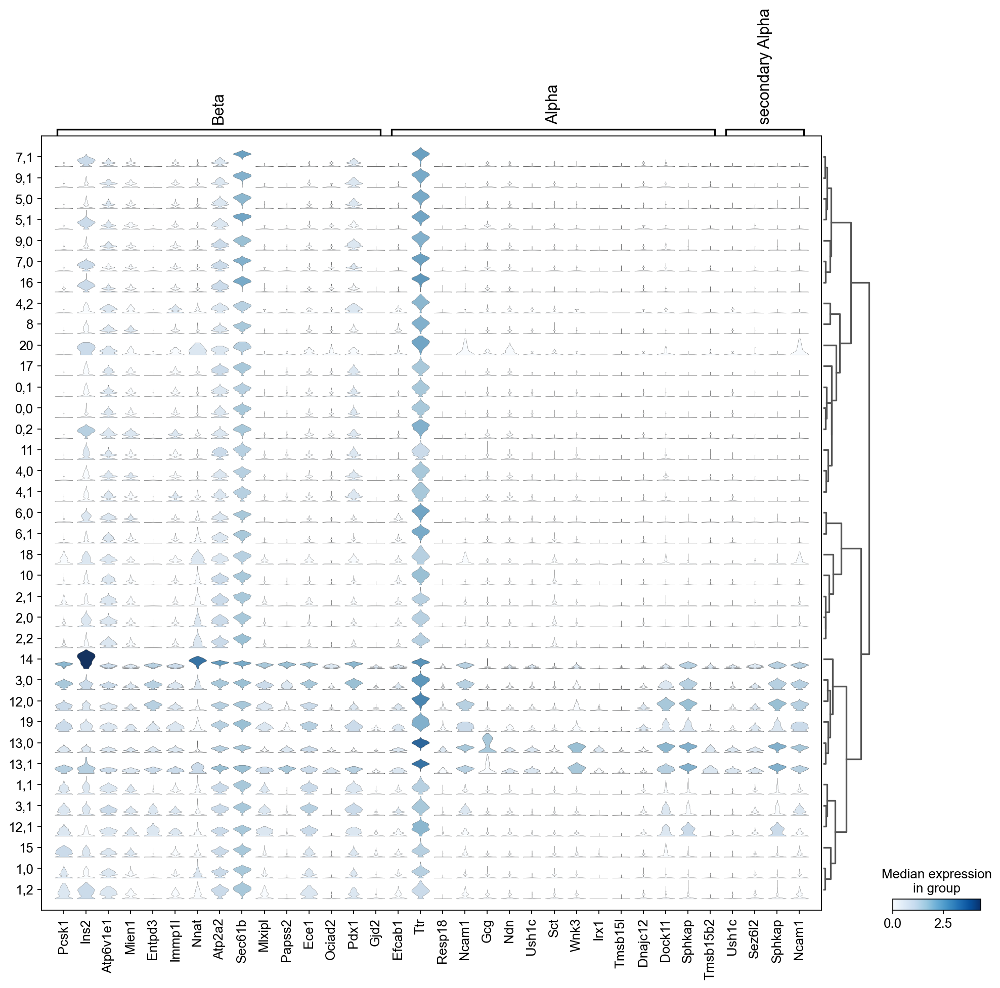

In [24]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Beta', 'Alpha', 'secondary Alpha']
}, groupby=new_key, dendrogram=True)

- 13,0 secondary Alpha
- 13,1: secondary Alpha


Subcluster 15

In [25]:
c_id = 15

In [26]:
init_clus_dict[str(c_id)]

['Fev+ Alpha', 'Fev+ Epsilon', 'Fev+']

In [27]:
orig_key = 'leiden_sub10'
new_key = 'leiden_sub11' 
new_rg_key = 'rg_sub11'
sub_key = str(c_id)

running Leiden clustering
    finished: found 38 clusters and added
    'leiden_sub11', the cluster labels (adata.obs, categorical) (0:00:00)


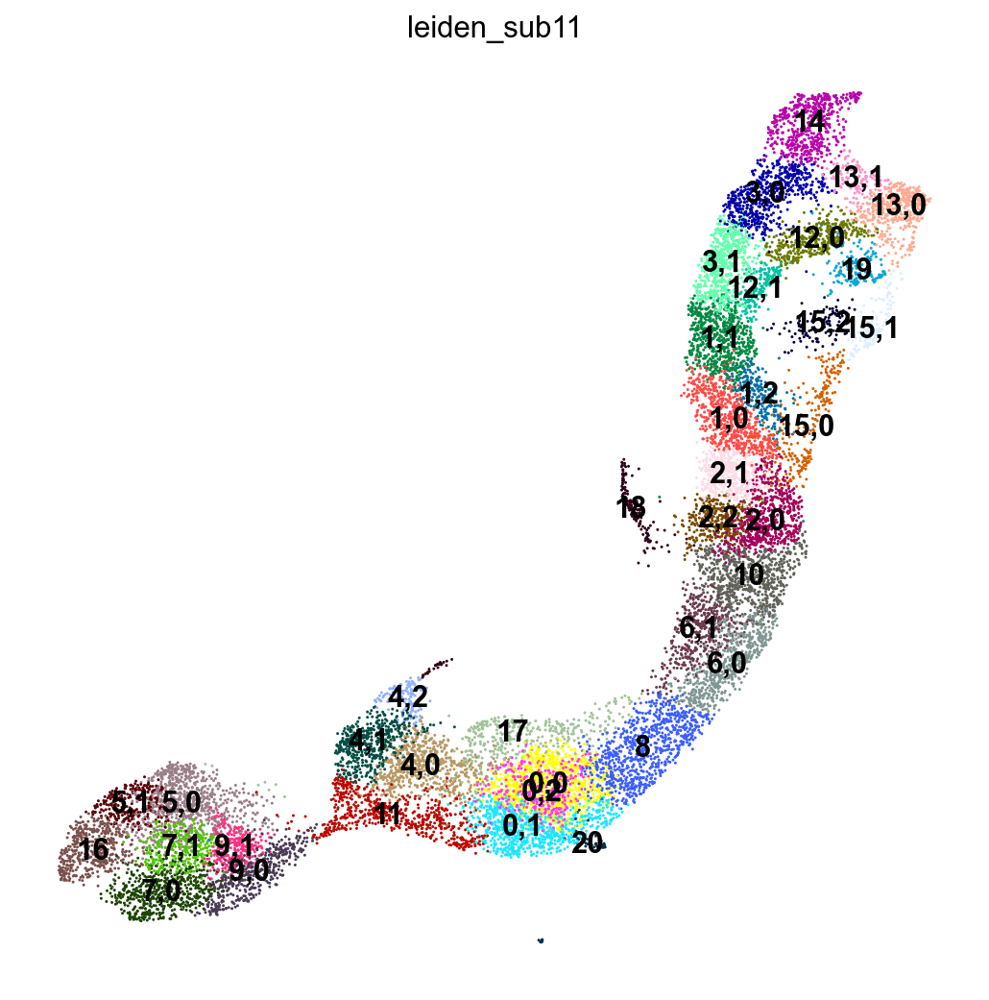

0,0     989
5,0     834
8       819
0,1     785
10      739
1,0     651
1,1     643
11      635
3,0     629
4,0     619
3,1     613
2,0     605
14      584
7,0     561
6,0     558
4,1     498
9,0     491
13,0    466
16      456
2,1     453
6,1     437
12,0    398
17      393
2,2     344
7,1     317
0,2     314
9,1     306
5,1     265
15,0    257
1,2     236
12,1    197
18      180
19      161
15,1    136
13,1    125
4,2     124
15,2    109
20       51
Name: leiden_sub11, dtype: int64

In [28]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub11']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Epsilon, Fev+ Epsilon, Fev+ Delta, etc.


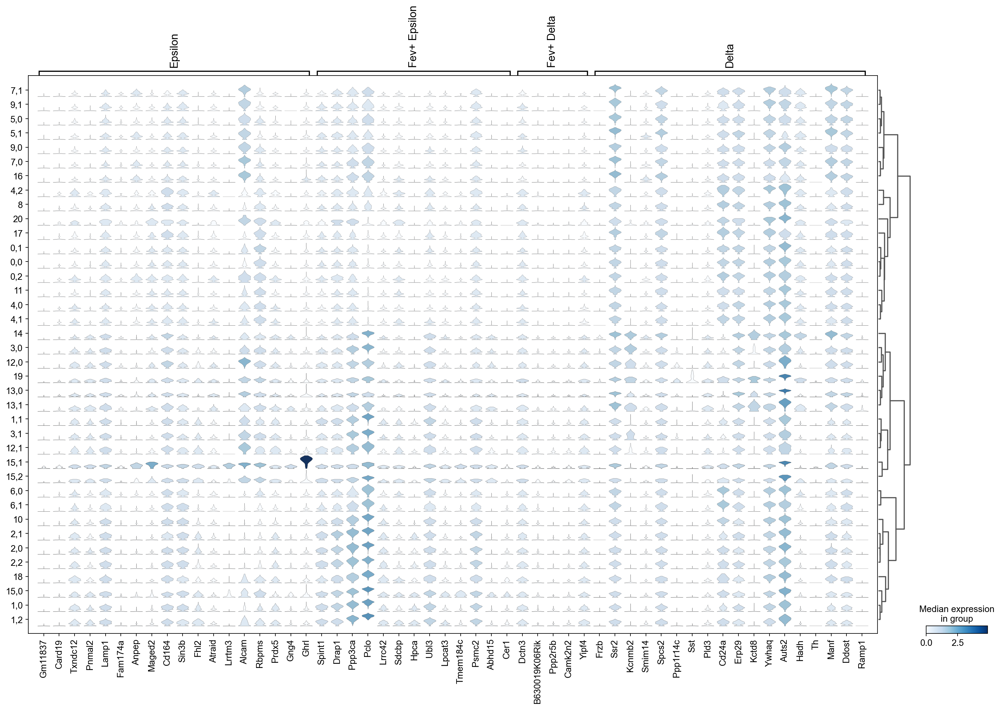

In [29]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Epsilon', 'Fev+ Epsilon', 'Fev+ Delta', 'Delta']
}, groupby=new_key, dendrogram=True)

- 15,0: Fev+ Epsilon
- 15,1: Epsilon
- 15,2: Fev+ Epsilon


Subcluster 18

In [30]:
c_id = 18

In [31]:
init_clus_dict[str(c_id)]

['Ngn3 High cycling', 'Prlf. Ductal', 'Ngn3 High early', 'Ngn3 High late']

In [32]:
orig_key = 'leiden_sub11'
new_key = 'leiden_sub12' 
new_rg_key = 'rg_sub12'
sub_key = str(c_id)

running Leiden clustering
    finished: found 40 clusters and added
    'leiden_sub12', the cluster labels (adata.obs, categorical) (0:00:00)


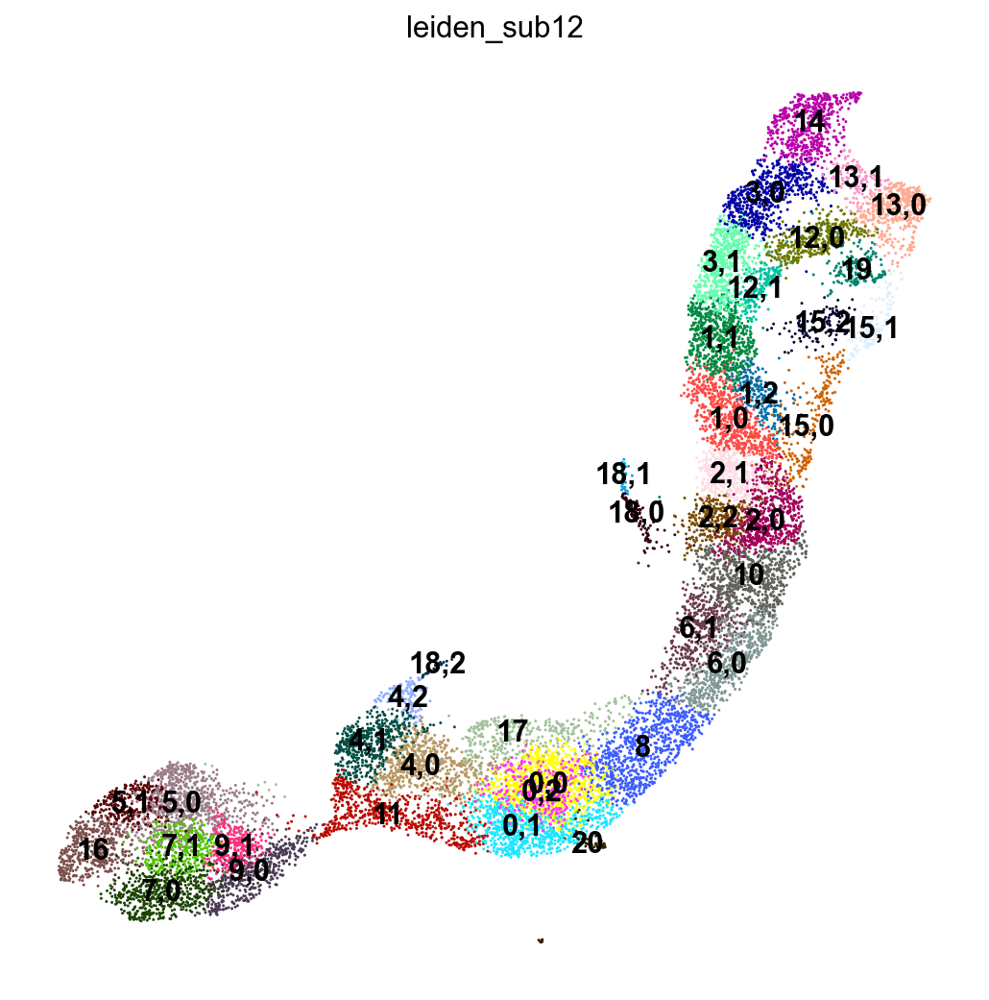

0,0     989
5,0     834
8       819
0,1     785
10      739
1,0     651
1,1     643
11      635
3,0     629
4,0     619
3,1     613
2,0     605
14      584
7,0     561
6,0     558
4,1     498
9,0     491
13,0    466
16      456
2,1     453
6,1     437
12,0    398
17      393
2,2     344
7,1     317
0,2     314
9,1     306
5,1     265
15,0    257
1,2     236
12,1    197
19      161
15,1    136
13,1    125
4,2     124
18,0    113
15,2    109
20       51
18,1     40
18,2     27
Name: leiden_sub12, dtype: int64

In [33]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub12']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Prlf. Ductal, Ductal


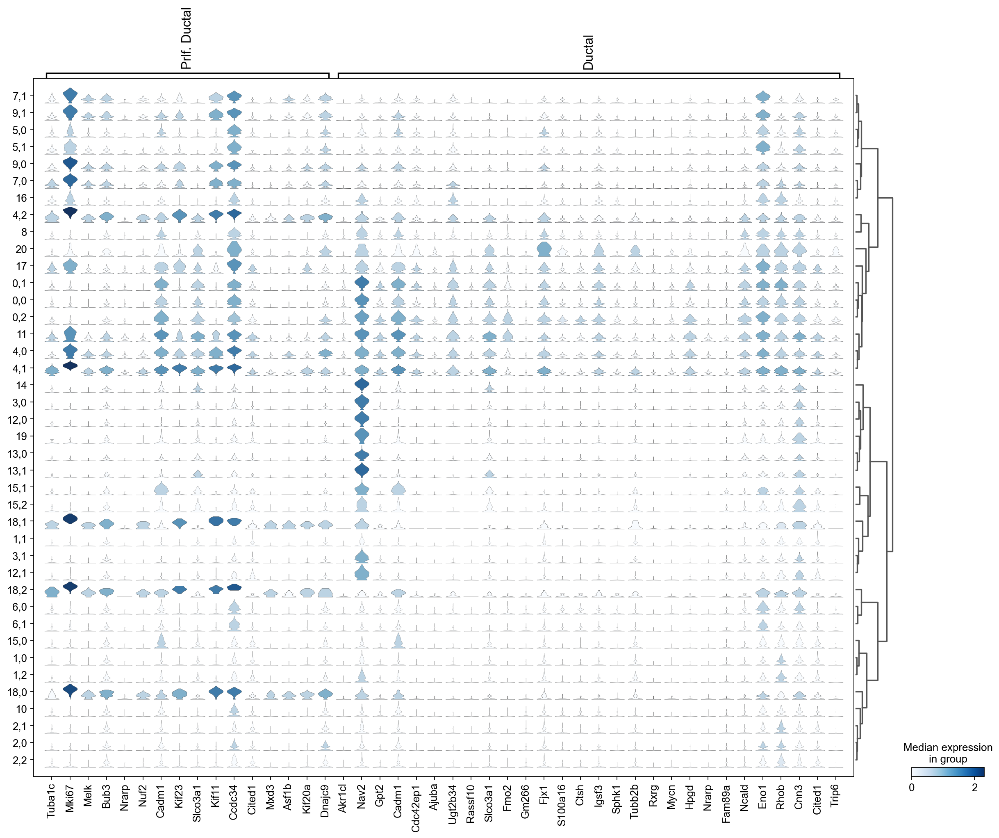

In [34]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Prlf. Ductal', 'Ductal']
}, groupby=new_key, dendrogram=True)


    "5,0": "Multipotent",
    "5,1": "Multipotent",
- 18,0: Ngn3 high cycling
- 18,1: Ngn3 high cycling
- 18,2: Prlf. Ductal


Subcluster 11

In [35]:
c_id = 11

In [36]:
init_clus_dict[str(c_id)]

['Multipotent', 'Ductal', 'Prlf. Ductal']

In [37]:
orig_key = 'leiden_sub12'
new_key = 'leiden_sub13' 
new_rg_key = 'rg_sub13'
sub_key = str(c_id)

running Leiden clustering
    finished: found 41 clusters and added
    'leiden_sub13', the cluster labels (adata.obs, categorical) (0:00:00)


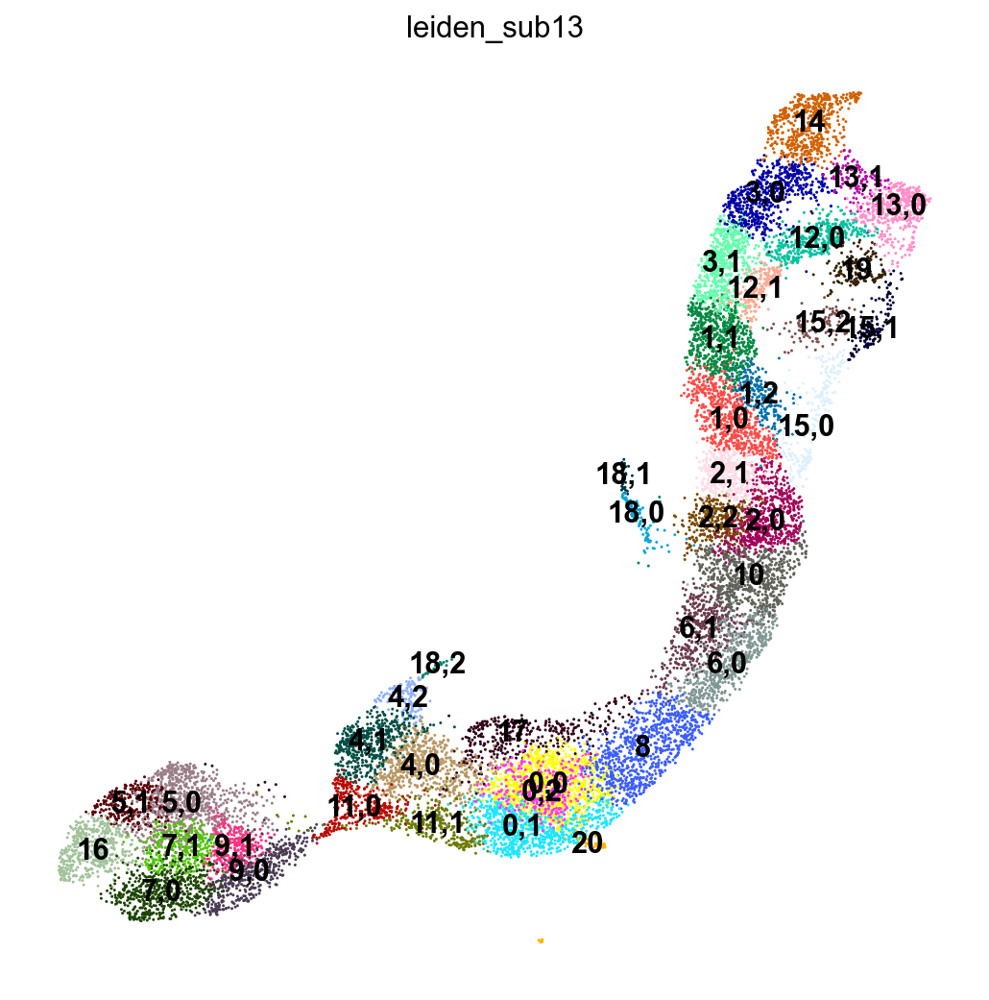

0,0     989
5,0     834
8       819
0,1     785
10      739
1,0     651
1,1     643
3,0     629
4,0     619
3,1     613
2,0     605
14      584
7,0     561
6,0     558
4,1     498
9,0     491
13,0    466
16      456
2,1     453
6,1     437
12,0    398
17      393
2,2     344
11,0    329
7,1     317
0,2     314
9,1     306
11,1    306
5,1     265
15,0    257
1,2     236
12,1    197
19      161
15,1    136
13,1    125
4,2     124
18,0    113
15,2    109
20       51
18,1     40
18,2     27
Name: leiden_sub13, dtype: int64

In [38]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub13']`
categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Multipotent, Prlf. Ductal, Ductal


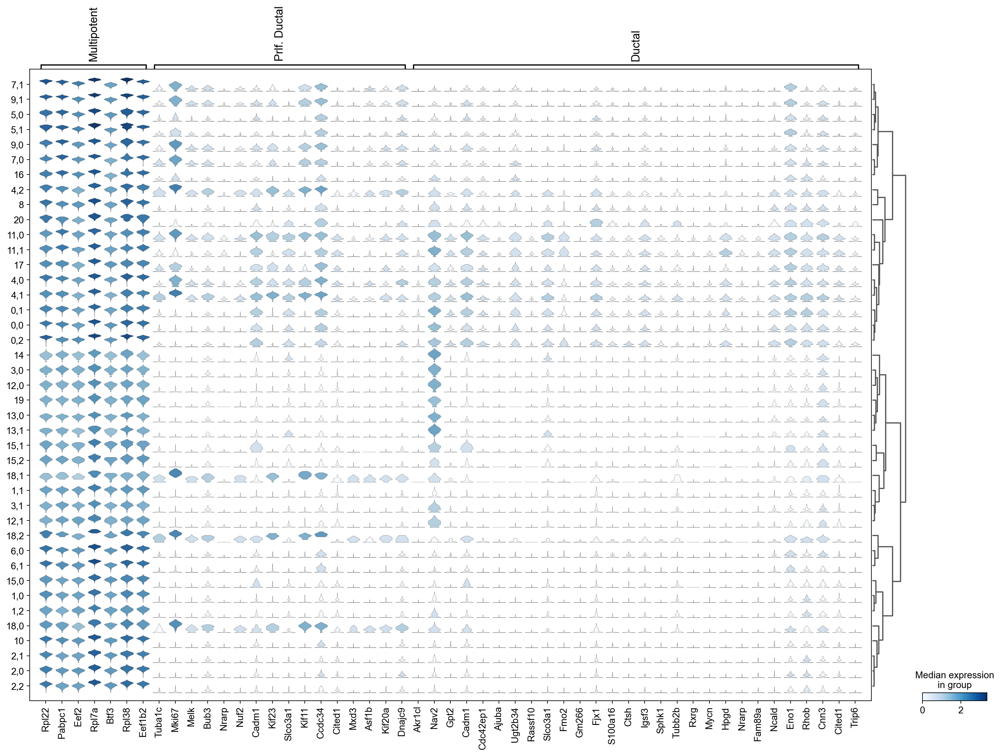

In [39]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Multipotent', 'Prlf. Ductal', 'Ductal']
}, groupby=new_key, dendrogram=True)


- 11,0: Multipotent
- 11,1: Ductal

Cluster 20

In [44]:
adata[adata.obs["leiden"]=="20"].obs["sample"].value_counts()

E15.5    33
E14.5    18
Name: sample, dtype: int64

categories: 0,0, 0,1, 0,2, etc.
var_group_labels: Ngn3 low EP, Prlf. Ductal, Ductal


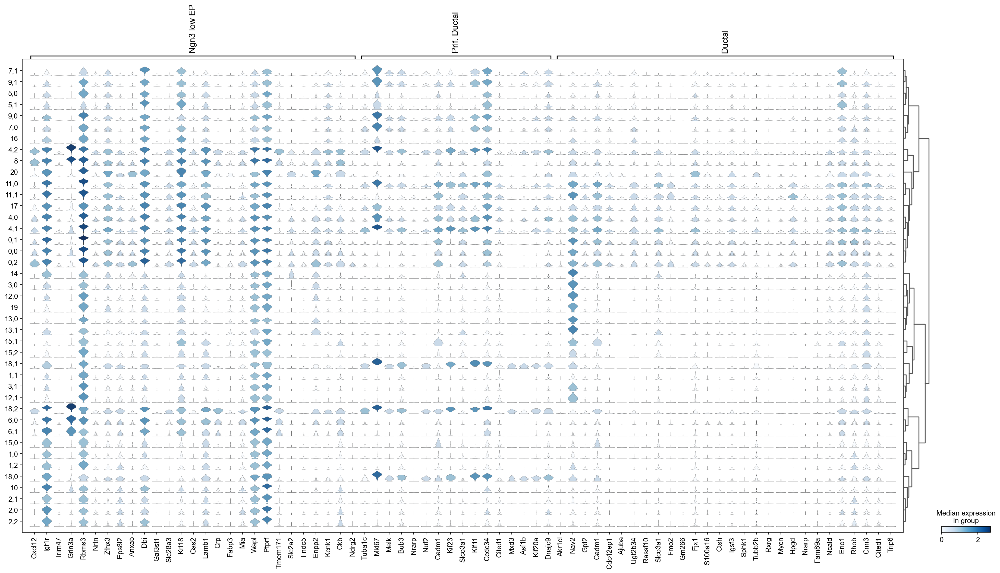

In [45]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Ngn3 low EP', 'Prlf. Ductal', 'Ductal']
}, groupby=new_key, dendrogram=True)

In [51]:
final_leiden = "leiden_sub13"

In [50]:
adata.obs.columns

Index(['n_counts', 'sample', 'int_id', 'reporter', 'log_cell_probs',
       'cell_barcodes_du', 'cell_barcodes_cr', 'cell_barcodes', 'log_counts',
       'n_genes',
       ...
       'leiden_sub4', 'leiden_sub5', 'leiden_sub6', 'leiden_sub7',
       'leiden_sub8', 'leiden_sub9', 'leiden_sub10', 'leiden_sub11',
       'leiden_sub12', 'leiden_sub13'],
      dtype='object', length=107)

In [75]:
new_cluster_names = {
    "0,0": "Ductal",
    "0,1": "Ductal",
    "0,2": "Ngn3 low EP",
    
    "1,0": "Fev+",
    "1,1": "Fev+",
    "1,2": "Fev+",

    "2,0": "Ngn3 High late",
    "2,1": "Ngn3 High late",
    "2,2": "Ngn3 High late",
    
    
    "3,0": "Fev+ Beta",
    "3,1": "Fev+ Beta",
    
    "4,0": "Prlf. Ductal",
    "4,1": "Prlf. Ductal",
    "4,2": "Prlf. Ductal",

    "5,0": "Multipotent",
    "5,1": "Prlf. Acinar",


    "6,0": "Ngn3 High early",
    "6,1": "Ngn3 High early",

    "7,0": "Mat. Acinar",
    "7,1": "Prlf. Acinar",
    
    "8": "Ngn3 low EP",

    "9,0": "Multipotent",
    "9,1": "Multipotent",
    
    "10": "Ngn3 High early", 
    
    "11,0": "Multipotent",
    "11,1": "Ductal",
    
    "12,0": "Alpha",
    "12,1": "Fev+ Alpha",

    "13,0": "secondary Alpha",
    "13,1": "secondary Alpha",

    "14": "Beta",
    
    "15,0": "Fev+ Epsilon",
    "15,1": "Epsilon",
    "15,2": "Fev+ Epsilon",
    
    "16": "Mat. Acinar",
    
    "17": "Prlf. Ductal",

    "18,0": "Ngn3 high cycling",
    "18,1": "Ngn3 high cycling",
    "18,2": "Prlf. Ductal",
    
    "19": "Delta",
    
    "20": "Ductal",
}
ct_column = 'celltype_new'
adata.obs[ct_column] = adata.obs[final_leiden].astype("str").values
for key in new_cluster_names.keys():
    adata.obs[ct_column][adata.obs[ct_column]==key] = new_cluster_names[key]
adata.obs[ct_column] = adata.obs[ct_column].astype("category")
#adata.obs.celltype = adata.obs.celltype.cat.rename_categories(new_cluster_names)

/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_34883/2982836557.py:69: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs[ct_column][adata.obs[ct_column]==key] = new_cluster_names[key]
/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_34883/2982836557.py:69: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs[ct_column][adata.obs[ct_column]==key] = new_cluster_names[key]
/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_34883/2982836557.py:69: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://p

In [76]:
[key for key in marker_genes_mouse2.keys() if key in adata.obs[ct_column].cat.categories]

['Multipotent',
 'Prlf. Acinar',
 'Mat. Acinar',
 'Ductal',
 'Prlf. Ductal',
 'Ngn3 low EP',
 'Ngn3 High early',
 'Ngn3 High late',
 'Fev+ Beta',
 'Beta',
 'Fev+ Alpha',
 'secondary Alpha',
 'Alpha',
 'Fev+ Epsilon',
 'Delta',
 'Epsilon']

In [77]:
set(adata.obs[ct_column].cat.categories).difference(set([key for key in marker_genes_mouse2.keys() if key in adata.obs[ct_column].cat.categories]))

{'Fev+', 'Ngn3 high cycling'}

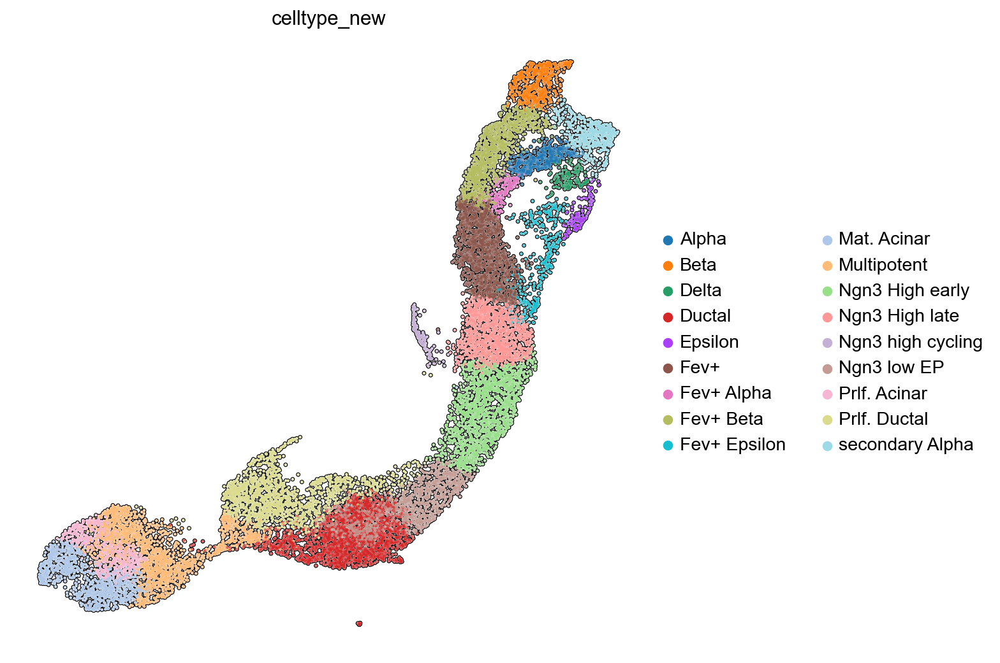

In [78]:
sc.pl.umap(adata, color=ct_column, size=15, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), color_map=ch_YlRd)

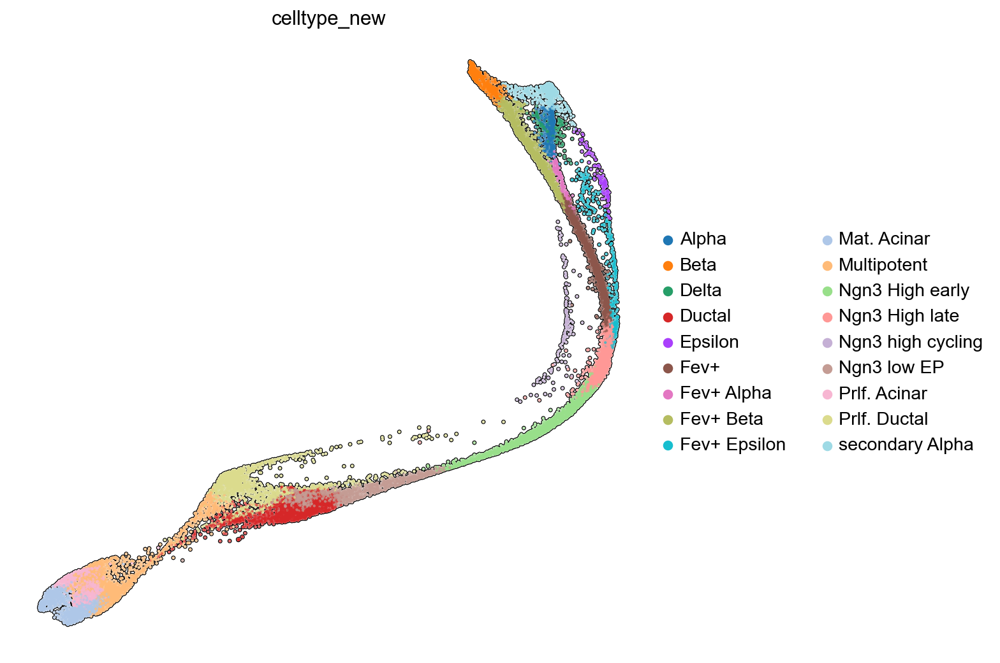

In [80]:
sc.pl.draw_graph(adata, color=ct_column, size=15, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), color_map=ch_YlRd)

In [81]:
# Save
sc.write('/Users/dominik.klein/data/E14-E15_adata_filtered_rmDoublets_sctNormalized_WNN_embedded_initialAnno_new_annotation.h5ad', adata)